In [1]:
!pip install ultralytics roboflow

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 30.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.9/89.9 kB 10.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 6.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.9/49.9 MB 20.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 78.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.2/4.2 MB 136.1 MB/s eta 0:00:00
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.12.0.88
    Uninstalling opencv-python-headless-4.12.0.88:
      Successfully uninstalled opencv-python-headless-4.12.0.88
  Attempting uninstall: idna
    Found existing installation: idna 3.11
    Uninstalling idna-3.11:
      Successfully uninstalled idna-3.11


In [2]:
from roboflow import Roboflow

rf = Roboflow(api_key="S4z3qbhLjzpZYlqubJ0d")
project = rf.workspace("fourise").project("smart-city-tm05d")
version = project.version(1)
dataset = version.download("yolov8")

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to smart-city-1 in yolov8:: 100%|██████████| 8170/8170 [00:01<00:00, 5995.92it/s]


Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [ ]:
from ultralytics import YOLO
import os

model = YOLO('yolov8m.pt')

data_yaml_path = os.path.join(dataset.location, 'data.yaml')

results = model.train(
    data=data_yaml_path,      
    epochs=100,               
    imgsz=640,                
    batch=16,                 
    name='smart_city_model_high_acc', 

    patience=20,              
    
    optimizer='AdamW',        

    # Data Augmentation 
    mosaic=1.0,               # 1.0 (default) enables mosaic augmentation on 100% of images
    mixup=0.05,               # Mixup can help, start with a small value (Default is 0.0)

    device=0       #GPU           
)

Ultralytics 8.3.237 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/smart-city-1/data.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.05, mode=train, model=yolov8m.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=smart_city_model_high_acc, nbs=64, nms=False, opset=None, optimize=False, optimizer=AdamW, overlap_mask=True, patience=20, perspective=0

In [ ]:
from ultralytics import YOLO
import os


RUN_NAME = 'smart_city_model_high_acc'

best_model_path = f'/content/runs/detect/{RUN_NAME}/weights/best.pt'

# Load the best model found during training
print(f"Attempting to load model from: {best_model_path}")
best_model = YOLO(best_model_path)

metrics = best_model.val()

print("\n--- Validation Metrics ---")
print(f"Map50-95: {metrics.box.map}")  
print(f"Map50:    {metrics.box.map50}") 

Attempting to load model from: /content/runs/detect/smart_city_model_high_acc/weights/best.pt
Ultralytics 8.3.237 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 92 layers, 25,840,918 parameters, 0 gradients, 78.7 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1802.4±610.5 MB/s, size: 84.6 KB)
val: Scanning /content/smart-city-1/valid/labels.cache... 562 images, 7 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 562/562 1.1Mit/s 0.0s
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 56, len(boxes) = 623. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 36/36 2.3it/s 15.7s
                   all        562        623      0.877      0.863      0.901      0.605
               garbage        434

Running inference on sample image: /content/smart-city-1/valid/images/images270_jpg.rf.f6fa87aaf107d7f78871ff76209dd136.jpg

image 1/1 /content/smart-city-1/valid/images/images270_jpg.rf.f6fa87aaf107d7f78871ff76209dd136.jpg: 640x640 1 garbage, 38.5ms
Speed: 5.5ms preprocess, 38.5ms inference, 7.3ms postprocess per image at shape (1, 3, 640, 640)

--- Predicted Output with Bounding Boxes ---


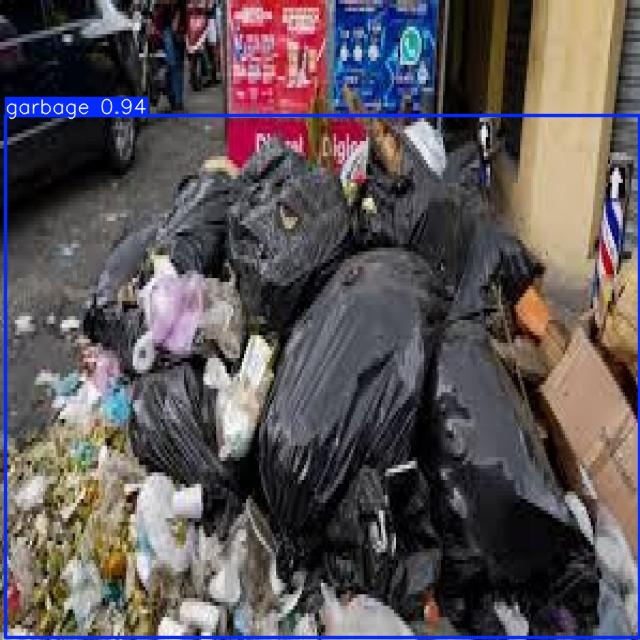

In [ ]:
import glob
from IPython.display import Image, display

SAMPLE_IMAGE_PATH = os.path.join(dataset.location, 'valid', 'images', '*')

sample_image = glob.glob(SAMPLE_IMAGE_PATH)[0]

print(f"Running inference on sample image: {sample_image}")

results = best_model(sample_image)

predicted_image_path = os.path.join('/content/', 'predicted_output.jpg')
results[0].save(predicted_image_path)

# Display the image with predictions
print("\n--- Predicted Output with Bounding Boxes ---")
display(Image(filename=predicted_image_path))

Found correct folder: /content/runs/detect/smart_city_model_high_acc


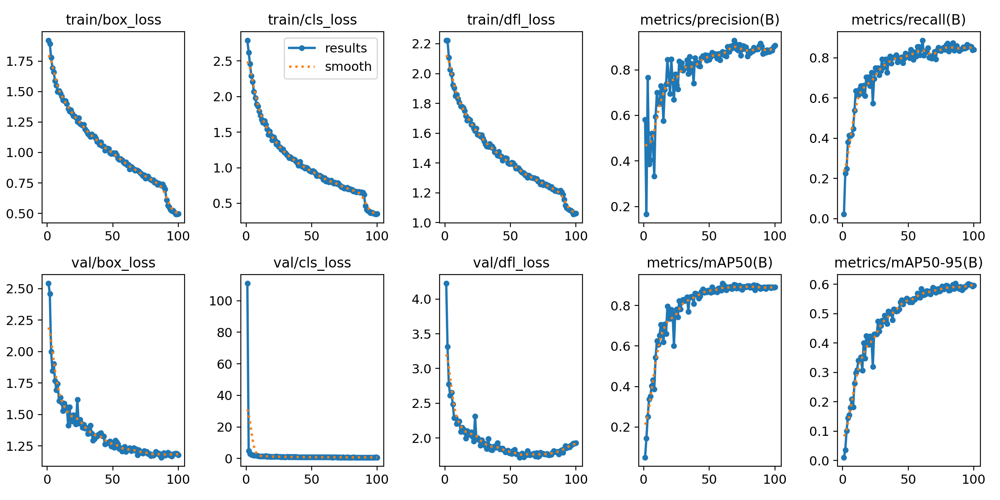

In [ ]:
import glob
import os
from IPython.display import Image, display

# 1. Search for any folder inside 'detect' that starts with 'smart_city'
found_folders = glob.glob('/content/**/detect/smart_city*', recursive=True)

if found_folders:
    # 2. Pick the most recent folder (in case there are multiple)
    latest_folder = max(found_folders, key=os.path.getctime)
    print(f"Found correct folder: {latest_folder}")

    # 3. Define the path to results.png
    results_path = f"{latest_folder}/results.png"

    # 4. Check if the image exists and display it
    if os.path.exists(results_path):
        display(Image(filename=results_path))
    else:
        print(f"Error: Found the folder '{latest_folder}', but 'results.png' is missing inside it.")
else:
    print("Error: Could not find any folder starting with 'smart_city' in the detect directory.")

Please upload an image for testing...


Saving Img (996).jpg to Img (996).jpg
Uploaded: Img (996).jpg
Loading model from: /content/runs/detect/smart_city_model_high_acc/weights/best.pt

image 1/1 /content/Img (996).jpg: 640x480 3 potholes, 46.9ms
Speed: 2.8ms preprocess, 46.9ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 480)


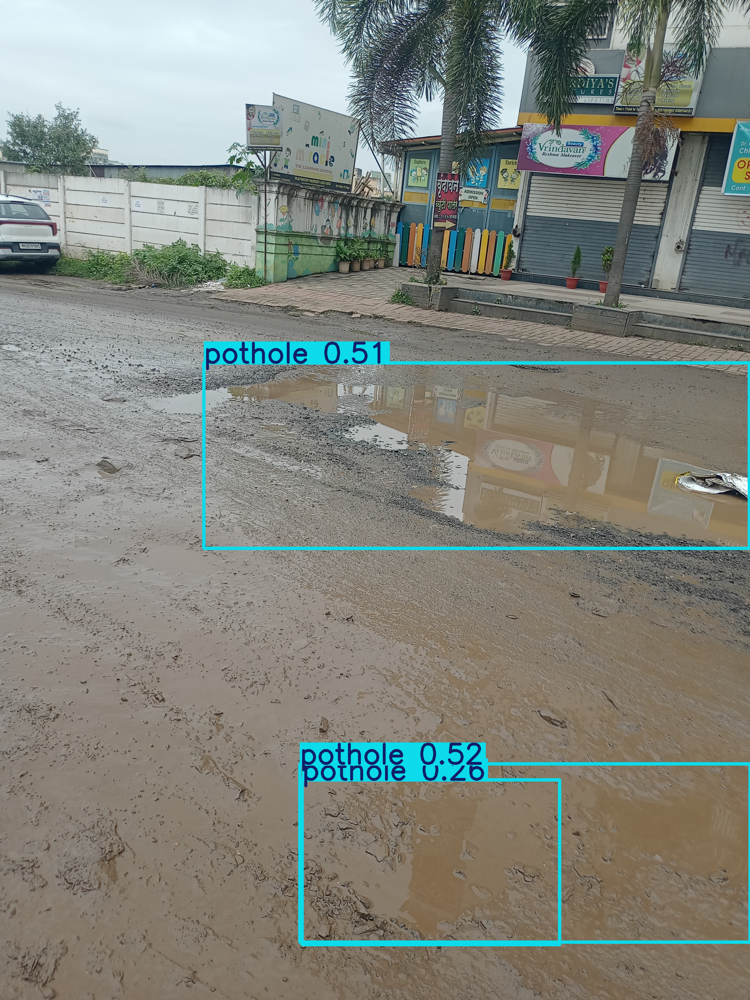

In [ ]:
import os
import glob
import cv2
from google.colab import files
from ultralytics import YOLO
from PIL import Image as PILImage
from IPython.display import display

# --- Step 1: Upload the Image ---
print("Please upload an image for testing...")
uploaded = files.upload()

if not uploaded:
    print("No file uploaded.")
else:
    filename = next(iter(uploaded))
    print(f"Uploaded: {filename}")

    # --- Step 2: Automatically Find the Best Model ---
    weights_list = glob.glob('/content/runs/detect/smart_city_model*/weights/best.pt')

    if weights_list:
        best_model_path = weights_list[0] 
        print(f"Loading model from: {best_model_path}")

        # --- Step 3: Load Model & Run Inference ---
        model = YOLO(best_model_path)
        results = model.predict(source=filename, conf=0.25) 

        # --- Step 4: Display the Result ---
        for result in results:
            img_array = result.plot()

            img_rgb = cv2.cvtColor(img_array, cv2.COLOR_BGR2RGB)

            # Display the image
            display(PILImage.fromarray(img_rgb))

    else:
        print("Error: Could not find 'best.pt'. Please check if training finished successfully.")